In [1]:
from argparse import ArgumentParser, Namespace
args = Namespace(expername="highresnettest",
                 gpus=1,
                 
                 epochs=1,
                 batch_size=1,
                 lr=0.001,
                 
                 clouds=False,
                 shiftnet=True,
                 loss='SSIM')
import torch
from pytorch_lightning.core import LightningDataModule, LightningModule
from pytorch_lightning.trainer import Trainer
from pytorch_lightning.loggers import WandbLogger
from pytorch_lightning.callbacks import ModelCheckpoint
from torch.utils.data import DataLoader

from src.datasets import SpaceNet7ConcatDataset
from src.highresnet import HighResNet
from src.datautils import ConcatPadPTwoCollate
from src.datamodules import SN7DataModule
import pandas as pd
from src.datasources import S2_BANDS
net_args = Namespace(in_channels=3, channel_size=64, out_channels=3, revisits_residual=True, additional_scaling=1.044)
model = HighResNet(net_args, lr= args.lr, lr_decay=0.9, lr_patience=3, clouds=args.clouds, shiftnet=args.shiftnet, loss=args.loss)

In [2]:
date_range = pd.date_range(start=f"2019-12-30", end=f"2020-01-31")
dm = SN7DataModule(date_range=date_range,s2_bands=S2_BANDS['true_color'],
#                    window_size=402, force_size=192, 
#                    samples=46, 
                   only_whole_scenes=True,
                   batch_size=args.batch_size, collate_2toN=True, normalize=True, standardize_sentinel=False)
dm.setup()

In [3]:
import torch
device = torch.device('cuda')
ssim_shift = HighResNet(net_args, lr= args.lr, lr_decay=0.9, lr_patience=3, clouds=args.clouds, shiftnet=True, loss=args.loss)
checkpoint = torch.load('/home/muhammed/lightning_saves/hrnet_SSIM_shift-epoch=24-step=46874.ckpt',map_location=device)
ssim_shift.load_state_dict(checkpoint['state_dict'])
ssim_shift = ssim_shift.cuda()

mse_noshift = HighResNet(net_args, lr= args.lr, lr_decay=0.9, lr_patience=3, clouds=args.clouds, shiftnet=False, loss=args.loss)
checkpoint = torch.load('/home/muhammed/lightning_saves/hrnet_MSE_shift-epoch=24-step=46874.ckpt',map_location=device)
mse_noshift.load_state_dict(checkpoint['state_dict'])
mse_noshift = mse_noshift.cuda()

In [4]:
import os, rasterio
superres_outputs = []
highres_list = []
lowres_list = []
scenes = []
dims = []
import numpy as np
import rasterio
with torch.no_grad():
    for idx, batch in enumerate(dm.val_dataloader()):
        lowres = batch['lowres']
        highres = batch['highres']
        lowres['images'], lowres['revisits_indicator'] = lowres['images'].cuda(), lowres['revisits_indicator'].cuda()
        _, _ , _, H, W = lowres['images'].shape
        if H > W:
            S = W
        if W > H:
            S = H
        else:
            S = H
        if S%2 == 1:
            S -= 1
        print(S)
        lowres['images'] = lowres['images'][:,:,:,:488,:488]
        superres_ssim = np.round(ssim_shift(lowres).squeeze().cpu().numpy()*255).astype(np.uint8)
        superres_outputs += [superres_ssim]
#         break
        highres_list += [highres['images'][0].cpu().numpy()]
        lowres_list += [lowres['images'].cpu().numpy()]
        scenes += lowres['scene'][0]
#         path_2_planet = "/data/spacenet/train/"+scene+"/images/global_monthly_2020_01_mosaic_"+scene+".tif"
#         path_2_save_dir = "/data/spacenet/train/"+scene+"/superres_ssim/"
#         os.makedirs(path_2_save_dir,exist_ok=True)
#         path_2_save_sr = "gs://fdl_srhallucinate/spacenet/train/"+scene+"/superres_ssim1/global_monthly_2020_01_mosaic_"+scene+".tif"
#         with rasterio.open(path_2_planet) as raster:
#             profile = {
#             "dtype": rasterio.uint8,
#             "crs": raster.crs,
#             "nodata": 0.,
#             "compress": "lzw",
#             "RESAMPLING": "CUBICSPLINE", # for pyramids
#             "transform": raster.transform,
#             }
#             save_cog(superres_ssim, path_2_save_sr, profile)
# #             save_cog_copy_gs(superres_ssim, path_2_save_sr, profile)
#             print(path_2_save_sr)

/home/muhammed/highresnet/lib/python3.7/site-packages/torchvision/transforms/functional.py:74: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:141.)
  img = torch.from_numpy(pic.transpose((2, 0, 1))).contiguous()
/home/muhammed/highresnet/lib/python3.7/site-packages/torchvision/transforms/functional.py:74: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before conver

490


/home/muhammed/highresnet/lib/python3.7/site-packages/torch/nn/functional.py:3103: UserWarning: The default behavior for interpolate/upsample with float scale_factor changed in 1.6.0 to align with other frameworks/libraries, and now uses scale_factor directly, instead of relying on the computed output size. If you wish to restore the old behavior, please set recompute_scale_factor=True. See the documentation of nn.Upsample for details. 
  warnings.warn("The default behavior for interpolate/upsample with float scale_factor changed "


490
490
490
490


In [5]:
from src.plot import show

In [6]:
same_size_highres = []
for highres in highres_list:
    same_size_highres += [highres[...,:1019,:1019]]

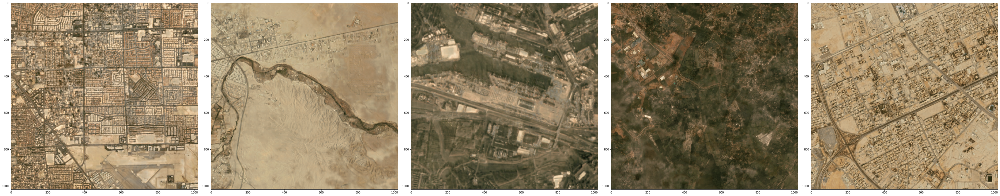

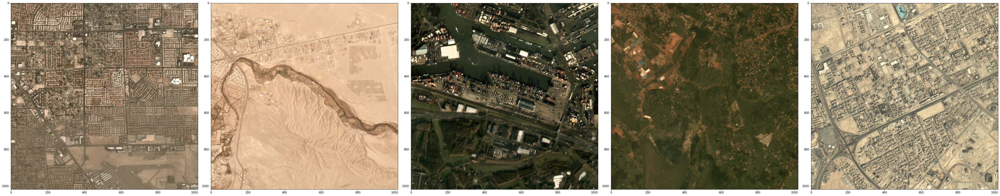

In [7]:
show(superres_outputs, figsize=10)
show(same_size_highres, figsize=10)

In [8]:
highres_list[0].shape

(1, 3, 1024, 1024)

In [9]:
from src.ssim_loss import ssim
import numpy as np

In [12]:
MSE = []
MAE = []
ssim_list = []
for i in range(5):
    MSE += [np.sqrt(np.mean((same_size_highres[i].squeeze() - superres_outputs[i].squeeze())**2, axis=0))]
    MAE += [np.mean(abs(same_size_highres[i].squeeze() - superres_outputs[i].squeeze()), axis=0)]
#     ssim_list += [ssim(torch.tensor(same_size_highres[i].squeeze()), torch.tensor(superres_outputs[i].squeeze()), reduction='none', full=True)]

In [13]:
MSE[0].shape

(1019, 1019)

In [ ]:
# block SSIM images into 20x20 patches

In [23]:
lowres_list[2].shape

(1, 8, 3, 488, 488)

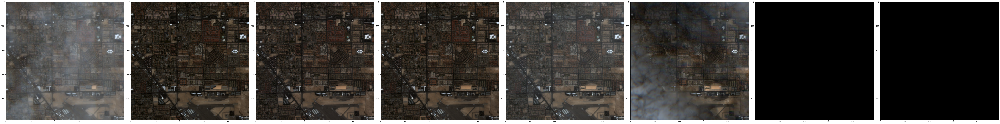

In [25]:
show(lowres_list[0].squeeze(), figsize=10)

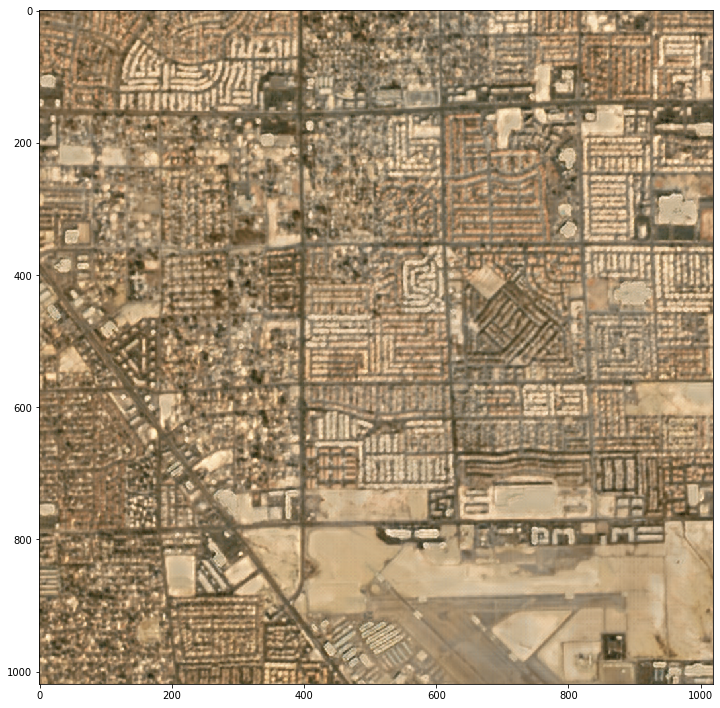

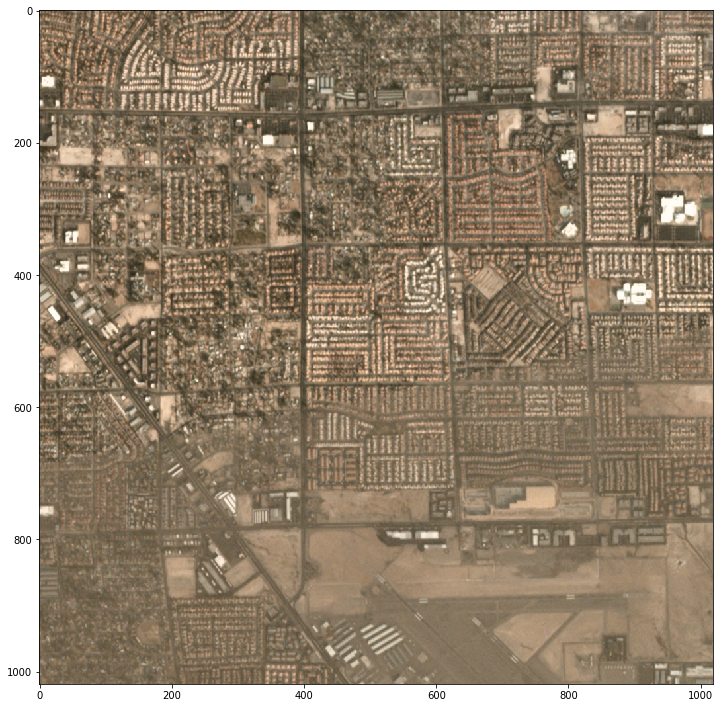

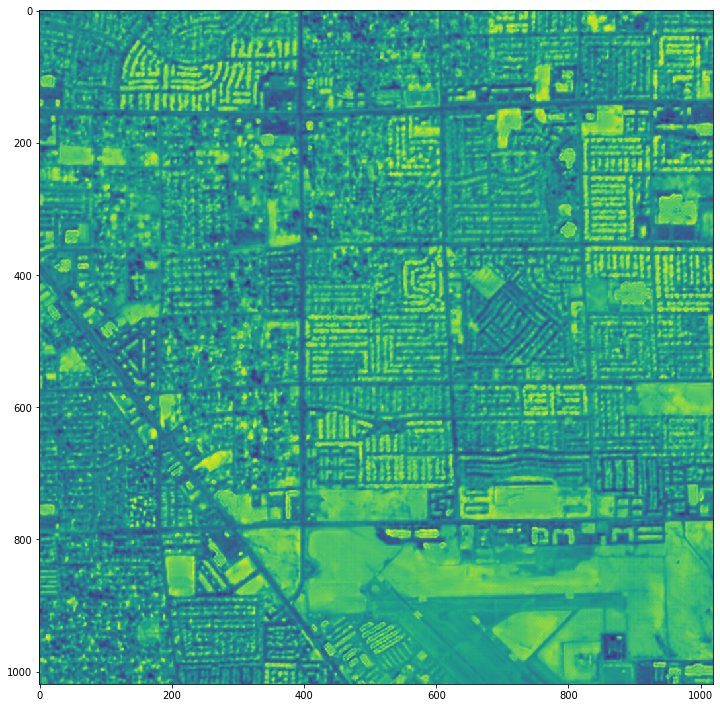

In [33]:
show(superres_outputs[0], figsize=10)
show(same_size_highres[0], figsize=10)
show(MSE[0], figsize=10)#, colorbar=True)
# show(MAE, figsize=5)

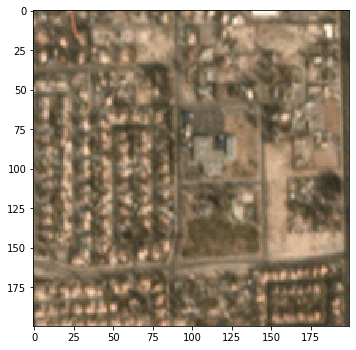

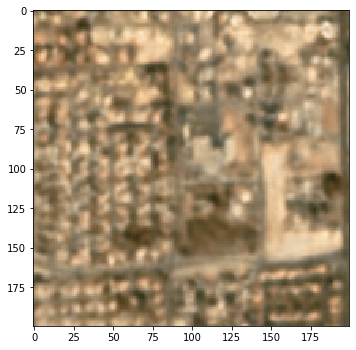

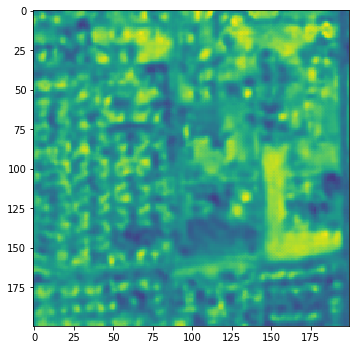

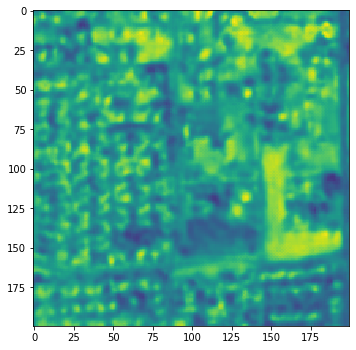

In [13]:
show(same_size_highres[0][...,200:400,200:400], figsize=5)
show(superres_outputs[0][...,200:400,200:400], figsize=5)
show(MSE[0][...,200:400,200:400], figsize=5)
show(MAE[0][...,200:400,200:400], figsize=5)

In [16]:
from typing import List, Optional, Tuple, Union, Iterable

import torch
import torch.nn.functional as F
from torch.nn.modules.loss import _Loss

#### PIQ/Functional/Filters
def gaussian_filter(kernel_size: int, sigma: float) -> torch.Tensor:
    r"""Returns 2D Gaussian kernel N(0,`sigma`^2)
    Args:
        size: Size of the kernel
        sigma: Std of the distribution
    Returns:
        gaussian_kernel: Tensor with shape (1, kernel_size, kernel_size)
    """
    coords = torch.arange(kernel_size).to(dtype=torch.float32)
    coords -= (kernel_size - 1) / 2.

    g = coords ** 2
    g = (- (g.unsqueeze(0) + g.unsqueeze(1)) / (2 * sigma ** 2)).exp()

    g /= g.sum()
    return g.unsqueeze(0)

def _adjust_dimensions(input_tensors: Union[torch.Tensor, Iterable[torch.Tensor]]):
    r"""Expands input tensors dimensions to 4D (N, C, H, W).
    """
    if isinstance(input_tensors, torch.Tensor):
        input_tensors = (input_tensors,)

    resized_tensors = []
    for tensor in input_tensors:
        tmp = tensor.clone()
        if tmp.dim() == 2:
            tmp = tmp.unsqueeze(0)
        if tmp.dim() == 3:
            tmp = tmp.unsqueeze(0)
        if tmp.dim() != 4 and tmp.dim() != 5:
            raise ValueError(f'Expected 2, 3, 4 or 5 dimensions (got {tensor.dim()})')
        resized_tensors.append(tmp)

    if len(resized_tensors) == 1:
        return resized_tensors[0]

    return tuple(resized_tensors)

def _ssim_per_channel(x: torch.Tensor, y: torch.Tensor, kernel: torch.Tensor,
                      data_range: Union[float, int] = 1., k1: float = 0.01,
                      k2: float = 0.03) -> Union[torch.Tensor, Tuple[torch.Tensor, torch.Tensor]]:
    r"""Calculate Structural Similarity (SSIM) index for X and Y per channel.

    Args:
        x: Tensor with shape (N, C, H, W).
        y: Tensor with shape (N, C, H, W).
        kernel: 2D Gaussian kernel.
        data_range: Value range of input images (usually 1.0 or 255).
        k1: Algorithm parameter, K1 (small constant, see [1]).
        k2: Algorithm parameter, K2 (small constant, see [1]).
            Try a larger K2 constant (e.g. 0.4) if you get a negative or NaN results.

    Returns:
        Full Value of Structural Similarity (SSIM) index.
    """

    if x.size(-1) < kernel.size(-1) or x.size(-2) < kernel.size(-2):
        raise ValueError(f'Kernel size can\'t be greater than actual input size. Input size: {x.size()}. '
                         f'Kernel size: {kernel.size()}')

    c1 = k1 ** 2
    c2 = k2 ** 2
    n_channels = x.size(1)
    mu1 = F.conv2d(x, weight=kernel, stride=1, padding=0, groups=n_channels)
    mu2 = F.conv2d(y, weight=kernel, stride=1, padding=0, groups=n_channels)

    mu1_sq = mu1.pow(2)
    mu2_sq = mu2.pow(2)
    mu1_mu2 = mu1 * mu2

    compensation = 1.0
    sigma1_sq = compensation * (F.conv2d(x * x, weight=kernel, stride=1, padding=0, groups=n_channels) - mu1_sq)
    sigma2_sq = compensation * (F.conv2d(y * y, weight=kernel, stride=1, padding=0, groups=n_channels) - mu2_sq)
    sigma12 = compensation * (F.conv2d(x * y, weight=kernel, stride=1, padding=0, groups=n_channels) - mu1_mu2)

    # Set alpha = beta = gamma = 1.
    cs_map = (2 * sigma12 + c2) / (sigma1_sq + sigma2_sq + c2)
    ssim_map = ((2 * mu1_mu2 + c1) / (mu1_sq + mu2_sq + c1)) * cs_map

#     ssim_val = ssim_map.mean(dim=(-1, -2))
#     cs = cs_map.mean(dim=(-1, -2))
    return ssim_map, cs_map

def ssim(x: torch.Tensor, y: torch.Tensor, kernel_size: int = 11, kernel_sigma: float = 1.5,
         data_range: Union[int, float] = 1., reduction: str = 'mean', full: bool = False,
         k1: float = 0.01, k2: float = 0.03) -> Union[torch.Tensor, Tuple[torch.Tensor, torch.Tensor]]:
    r"""Interface of Structural Similarity (SSIM) index.
    Inputs supposed to be in range [0, data_range] with RGB channels order for colour images.

    Args:
        x: Tensor with shape 2D (H, W), 3D (C, H, W), 4D (N, C, H, W) or 5D (N, C, H, W, 2).
        y: Tensor with shape 2D (H, W), 3D (C, H, W), 4D (N, C, H, W) or 5D (N, C, H, W, 2).
        kernel_size: The side-length of the sliding window used in comparison. Must be an odd value.
        kernel_sigma: Sigma of normal distribution.
        data_range: Value range of input images (usually 1.0 or 255).
        reduction: Specifies the reduction to apply to the output:
            ``'none'`` | ``'mean'`` | ``'sum'``. ``'none'``: no reduction will be applied,
        full: Return cs map or not.
        k1: Algorithm parameter, K1 (small constant, see [1]).
        k2: Algorithm parameter, K2 (small constant, see [1]).
            Try a larger K2 constant (e.g. 0.4) if you get a negative or NaN results.

    Returns:
        Value of Structural Similarity (SSIM) index. In case of 5D input tensors, complex value is returned
        as a tensor of size 2.

    References:
        .. [1] Wang, Z., Bovik, A. C., Sheikh, H. R., & Simoncelli, E. P.
           (2004). Image quality assessment: From error visibility to
           structural similarity. IEEE Transactions on Image Processing,
           13, 600-612.
           https://ece.uwaterloo.ca/~z70wang/publications/ssim.pdf,
           DOI: `10.1109/TIP.2003.819861`
    """
#     _validate_input(
#         input_tensors=(x, y), allow_5d=True, kernel_size=kernel_size, scale_weights=None, data_range=data_range)
    x, y = _adjust_dimensions(input_tensors=(x, y))

    x = x.type(torch.float32)
    y = y.type(torch.float32)
        
    x = x / data_range
    y = y / data_range

    kernel = gaussian_filter(kernel_size, kernel_sigma).repeat(x.size(1), 1, 1, 1).to(y)
    _compute_ssim_per_channel = _ssim_per_channel_complex if x.dim() == 5 else _ssim_per_channel
    ssim_map, cs_map = _compute_ssim_per_channel(x=x, y=y, kernel=kernel, k1=k1, k2=k2)
    ssim_val = ssim_map.mean(1)
    cs = cs_map.mean(1)

    if reduction != 'none':
        reduction_operation = {'mean': torch.mean,
                               'sum': torch.sum}
        ssim_val = reduction_operation[reduction](ssim_val, dim=0)
        cs = reduction_operation[reduction](cs, dim=0)

    if full:
        return ssim_val, cs

    return ssim_val

In [31]:
ssim_val = ssim(torch.tensor(superres_outputs[0]), torch.tensor(same_size_highres[0]), kernel_size=11)

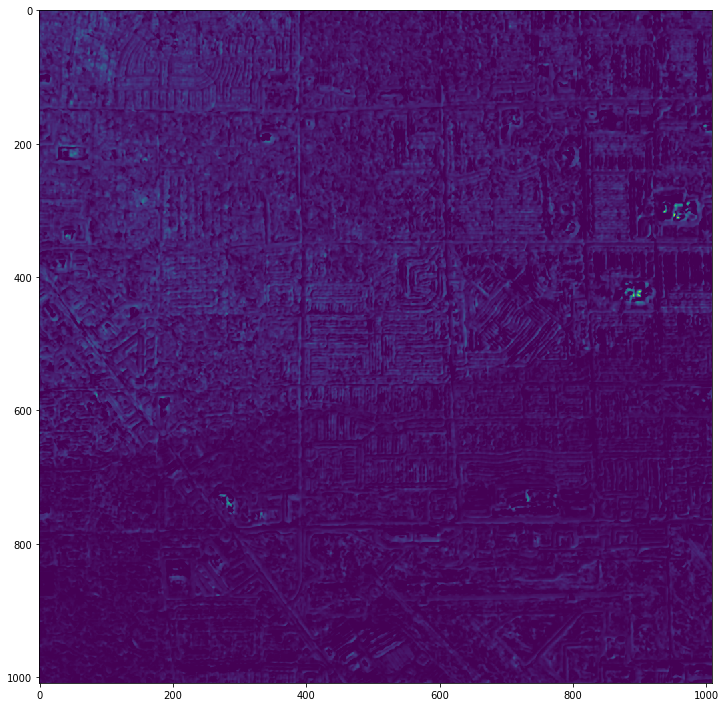

In [32]:
show(ssim_val,figsize=10)

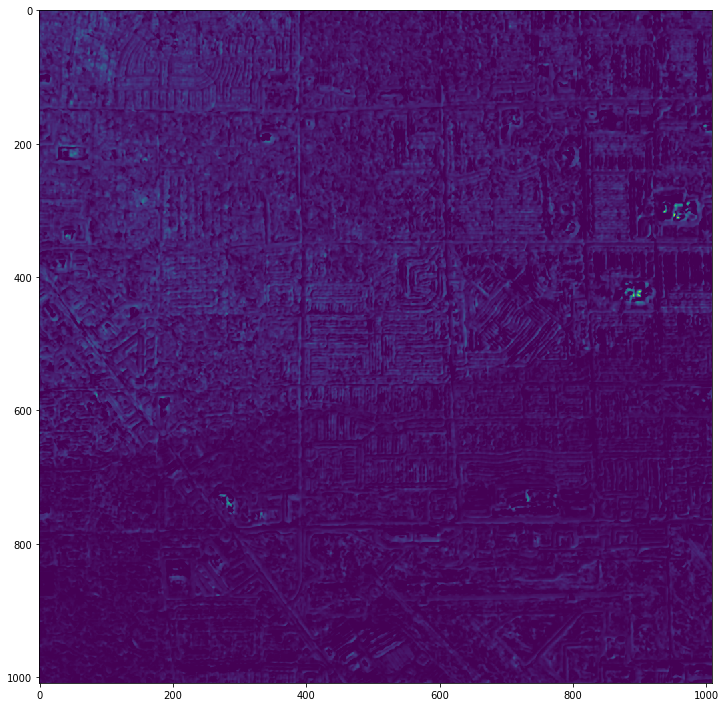

In [19]:
show(ssim_val,figsize=10)

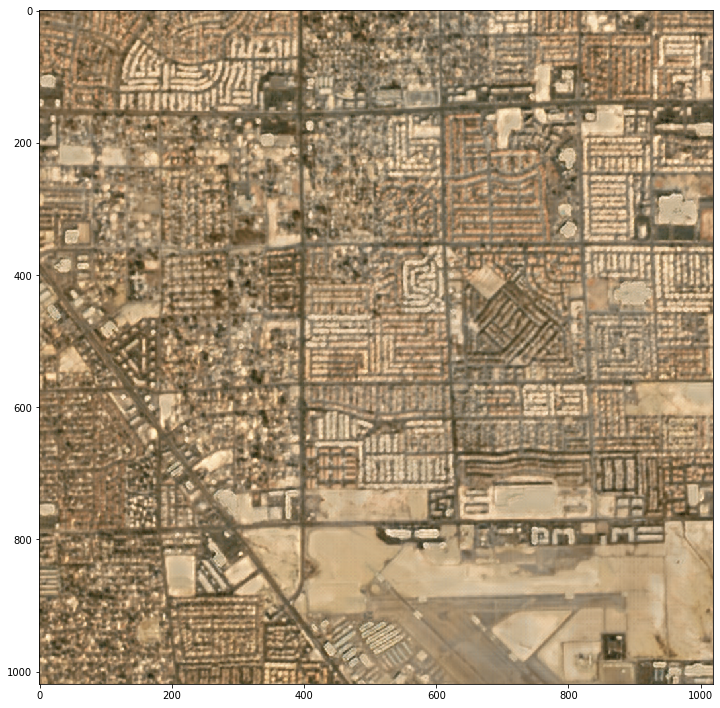

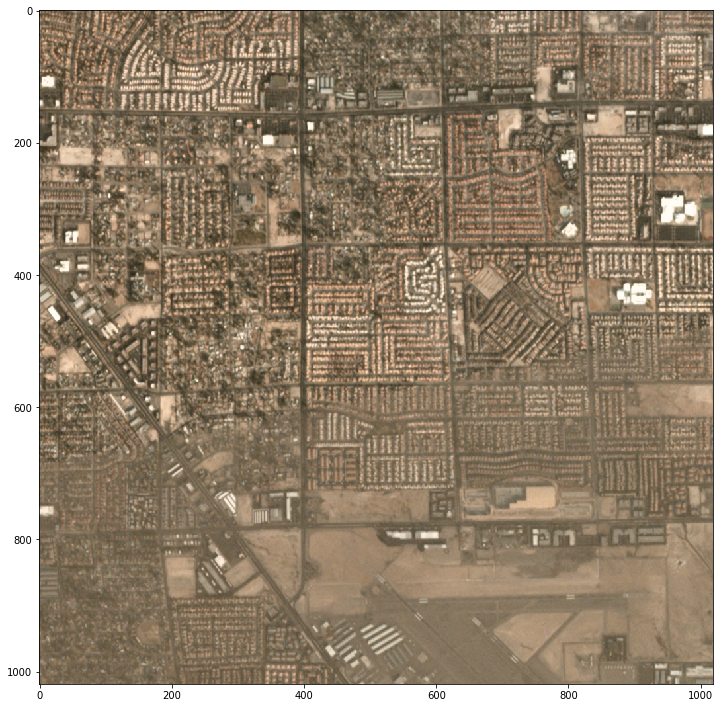

In [34]:
show(superres_outputs[0][...,20], figsize=10)
show(same_size_highres[0], figsize=10)